In [1]:
from collections import defaultdict
import datetime
from IPython.display import display
import os
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle
import sys
sys.path.extend(['input/sam-optimizer-pytorch', 'input/pytorch-image-models-master'])
from sam import SAM
import time
import torch
from torch.utils.data import DataLoader

In [2]:
#import sys
#!{sys.executable} -m pip install -r requirements.txt

In [3]:
from dataset import TrainDatasetV2, ValidDataset
import transforms as cassavatransforms
from train import sam_mixup_epoch, validate_model
from train_objects import get_model, get_optimizer, get_cycle_class_weight, get_lr_scheduler
from util import plot_curve_w_linefit

In [4]:
metadata = pd.read_csv('input/2019_2020_merged/train.csv')
label_map = pd.read_json('input/label_num_to_disease_map.json', typ='series')
keys = list(metadata['image_id'])
labels = list(metadata['label'])
image_map = list(zip(keys, labels))
image_source_map = pd.Series(metadata.source.values,index=metadata.image_id).to_dict()
config = pd.read_json('train_config.json', typ='series')
device = torch.device(config['device'])

torch.manual_seed(config['seed'])
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False
np.random.seed(config['seed'])

In [5]:
if config['timestamp'] is None:
    config['timestamp'] = datetime.datetime.now().strftime('%Y-%m-%d_%H-%M-%S')
config

seed                                                     12348
timestamp                                  2021-02-17_21-40-40
total_epochs                                                16
device                                                  cuda:0
model_name                               tf_efficientnet_b7_ns
batch_size                                                  12
target_size                                                512
target_size_valid                                          512
rrc_scale_min                                              0.4
rrc_scale_max                                              1.1
do_mixup                                                  True
do_cutmix                                                 True
p_cutmix                                                   0.4
do_depthmix                                               True
p_depthmix                                                0.05
mixup_alpha                                            

In [6]:
train_image_map, valid_image_map = train_test_split(image_map, test_size=0.05)
train_image_map = shuffle(train_image_map)

print(f'{len(train_image_map)} images in train set, {len(valid_image_map)} in validation set.')

24909 images in train set, 1311 in validation set.


In [7]:
if 'class_weight_base_formula' in config.keys() and config['class_weight_base_formula'] == 'logarithmic':
    inv_class_freq = 1 / metadata.groupby('label').count() 
    inv_class_freq = torch.Tensor(inv_class_freq['source'])
    log_inv_class_freq = torch.log(1 + inv_class_freq)
    base_class_weight = (log_inv_class_freq / log_inv_class_freq
                                 .sum(0)
                                 .expand_as(log_inv_class_freq))
else:
    inv_class_freq = 1 / metadata.groupby('label').count() 
    inv_class_freq = torch.Tensor(inv_class_freq['source'])
    normalized_inv_class_freq = (inv_class_freq / inv_class_freq
                                 .sum(0)
                                 .expand_as(inv_class_freq))
    base_class_weight = normalized_inv_class_freq
    base_class_weight /= torch.mean(base_class_weight)
'''
Class weighting will be modulated according to the class weight scheduler.
Thoughts: Try log scaling of weight?
'''
print('Weighting of classes:', base_class_weight)

Weighting of classes: tensor([0.3933, 0.1700, 0.1947, 0.0380, 0.2041])


In [8]:
train_transforms_presize, train_transforms_combine = cassavatransforms.get_presize_combine_transforms()
if 'transforms_ver' in config.keys() and config['transforms_ver'] == 2:
    train_transforms_presize, train_transforms_combine = cassavatransforms.get_presize_combine_transforms_V2()
elif 'transforms_ver' in config.keys() and config['transforms_ver'] == 3:
    train_transforms_presize, train_transforms_combine = cassavatransforms.get_presize_combine_transforms_V3()
elif 'transforms_ver' in config.keys() and config['transforms_ver'] == 4:
    train_transforms_presize, train_transforms_combine = cassavatransforms.get_presize_combine_transforms_V4()
tune_transforms_presize, tune_transforms_combine = cassavatransforms.get_presize_combine_tune_transforms()
valid_transforms = cassavatransforms.get_valid_transforms()

train = TrainDatasetV2(
    image_map=train_image_map,
    input_dir='input/2019_2020_merged/train_images',
    presize_transforms = train_transforms_presize,
    combine_transforms = train_transforms_combine,
    image_source_map = image_source_map,
    do_mixup = config['do_mixup'],
    do_cutmix = config['do_cutmix'],
    p_cutmix = config['p_cutmix'],
    p_depthmix = config['p_depthmix'],
    do_depthmix = config['do_depthmix'],
    depth_map_dir='input/2019_2020_merged/depth_maps',
)

train_tune = TrainDatasetV2(
    image_map=train_image_map,
    input_dir='input/2019_2020_merged/train_images',
    presize_transforms = tune_transforms_presize,
    combine_transforms = tune_transforms_combine,
    image_source_map = image_source_map,
    do_mixup = True,
    do_cutmix = False,
    p_cutmix = config['p_cutmix'],
    p_depthmix = config['p_depthmix'],
    do_depthmix = False,
    depth_map_dir='input/2019_2020_merged/depth_maps',
)

valid = ValidDataset(
    image_map=valid_image_map,
    input_dir='input/2019_2020_merged/train_images',
    transforms=valid_transforms,
    image_source_map = image_source_map)

train_loader = DataLoader(train, batch_size=config['batch_size'],
                        num_workers=16, drop_last=True, shuffle=True)

train_tune_loader = DataLoader(train_tune, batch_size=config['batch_size'],
                        num_workers=16, drop_last=True, shuffle=True)

valid_loader = DataLoader(valid, batch_size=config['batch_size'],
                        num_workers=16, drop_last=False, shuffle=False)

# Draw some samples

### Train loader

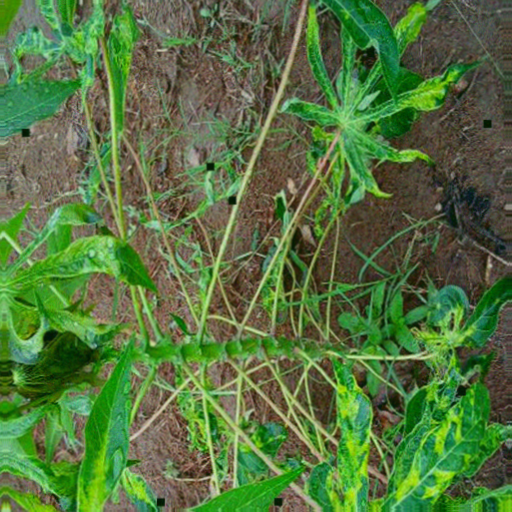

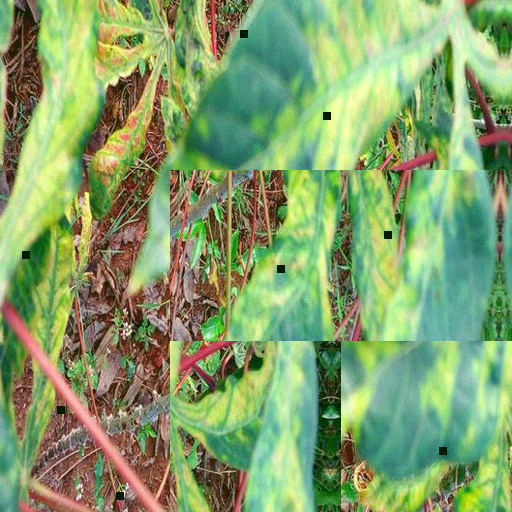

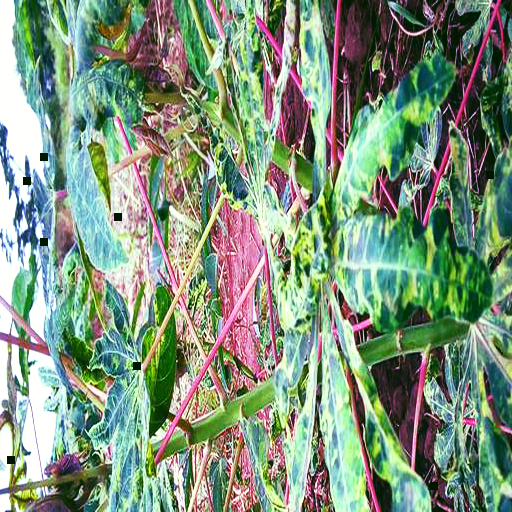

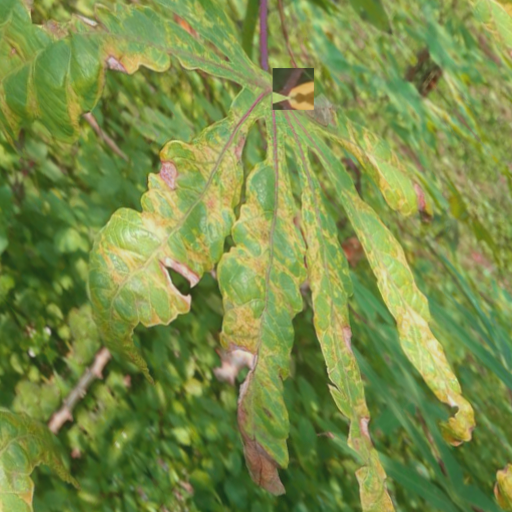

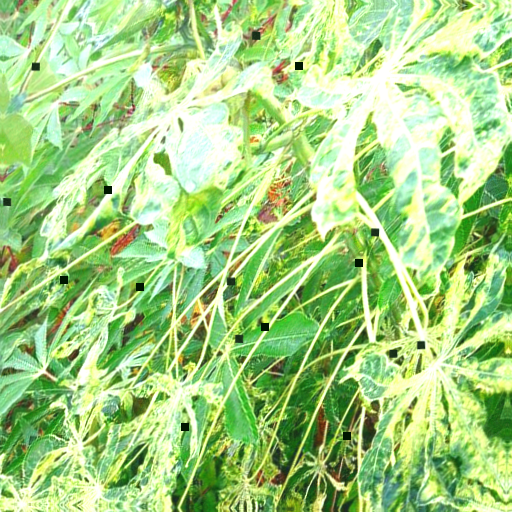

...

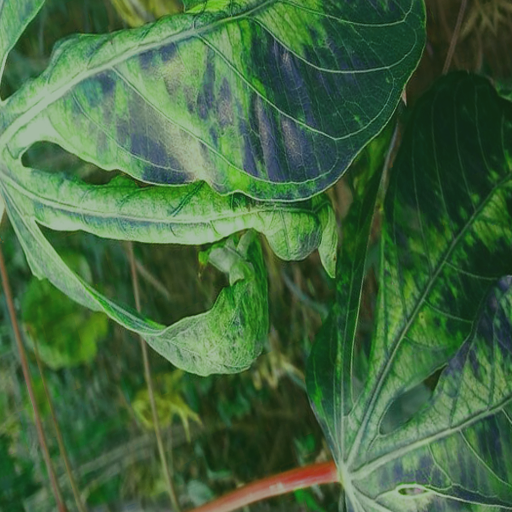

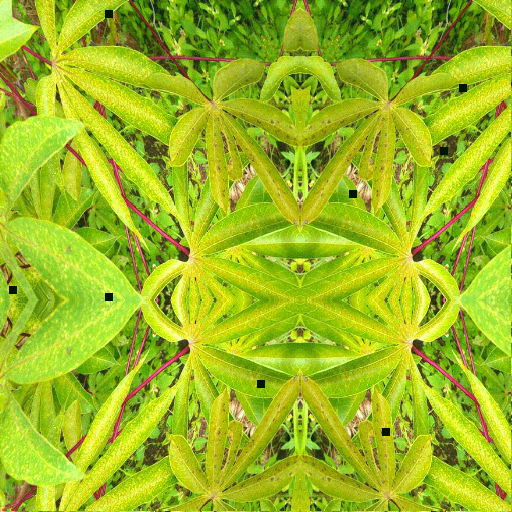

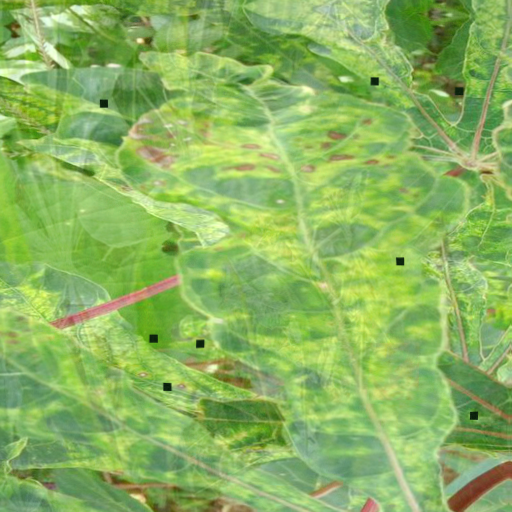

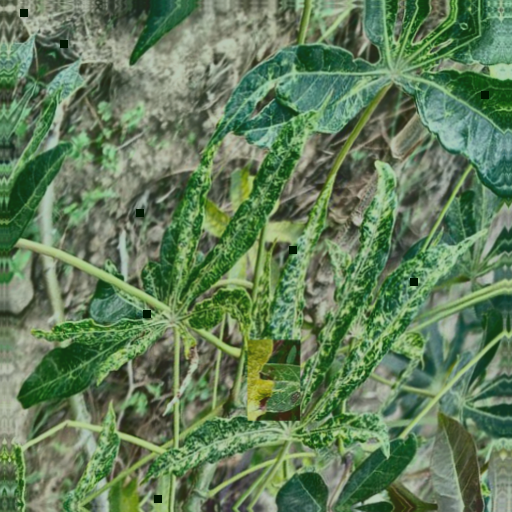

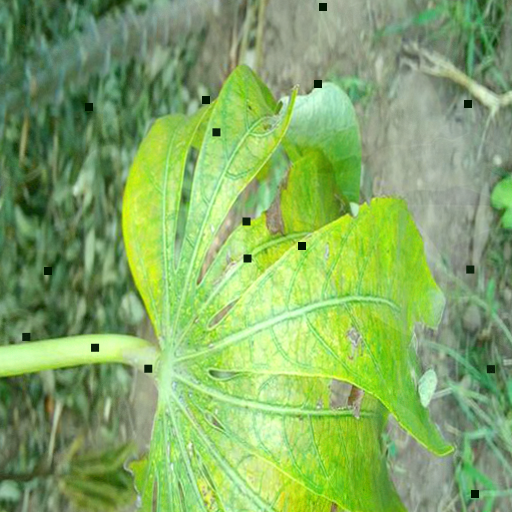

In [9]:
for i in range(32):
    display(train.image_at(i))

### Valid loader

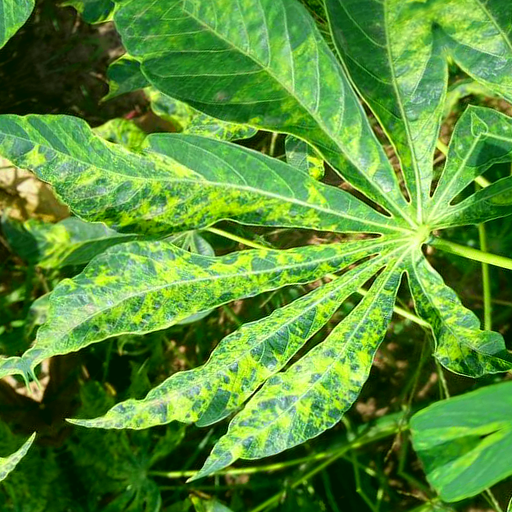

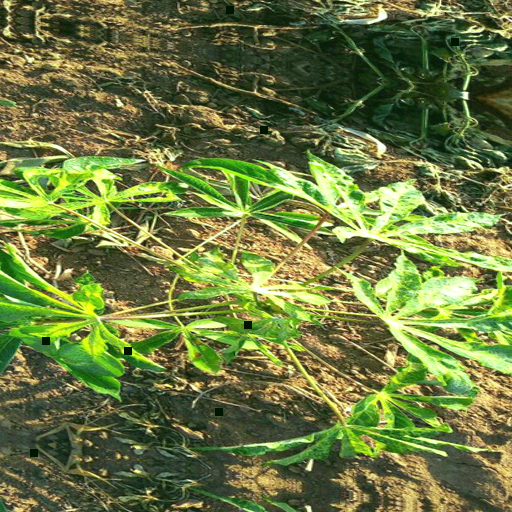

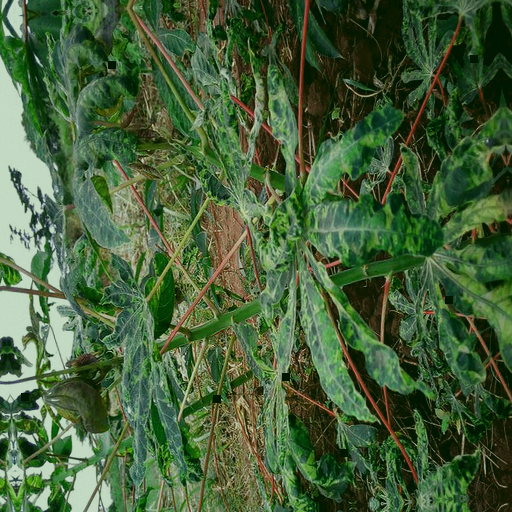

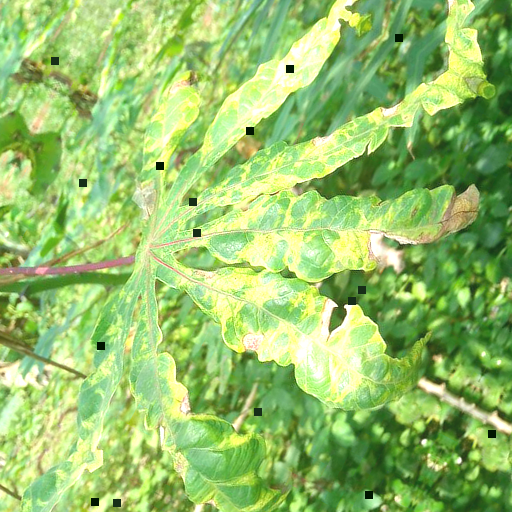

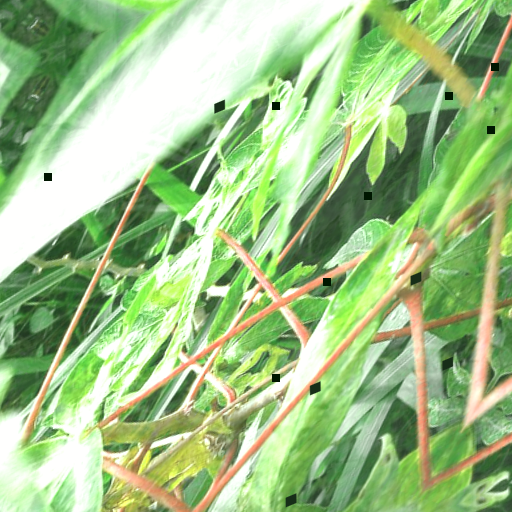

In [10]:
for i in range(5):
    display(train_tune.image_at(i))

In [11]:
model = get_model()
optimizer = get_optimizer(model)

criterion = torch.nn.CrossEntropyLoss(weight=base_class_weight, reduction='none')
criterion.to(device)

if 'cycle_class_weight_converge' in config.keys() and config['cycle_class_weight_converge'] == True:
    class_weight_scheduler = get_cycle_class_weight(criterion, 
                                                    base_class_weight, 
                                                    converge=True, 
                                                    steps_to_converge=len(train_loader) * config['cycle_class_weight_epochs_to_converge'])
else:
    class_weight_scheduler = get_cycle_class_weight(criterion, base_class_weight)


lr_scheduler = get_lr_scheduler(optimizer, config['total_epochs'], len(train_loader))

# Train

Running batch 2074

/home/raakforce/.local/lib/python3.6/site-packages/torch/optim/lr_scheduler.py:136: UserWarning: Detected call of `lr_scheduler.step()` before `optimizer.step()`. In PyTorch 1.1.0 and later, you should call them in the opposite order: `optimizer.step()` before `lr_scheduler.step()`.  Failure to do this will result in PyTorch skipping the first value of the learning rate schedule. See more details at https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate
  "https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate", UserWarning)


Running inference on validation batch 109

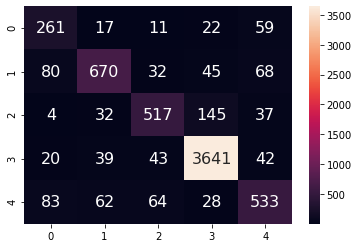

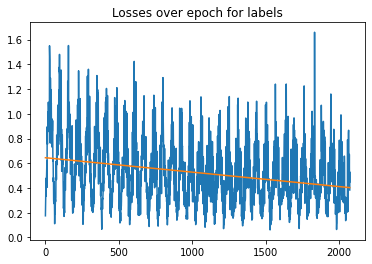

Intercept: 0.6450645741367494, slope: -0.00011657883033648024
Running inference on validation batch 109

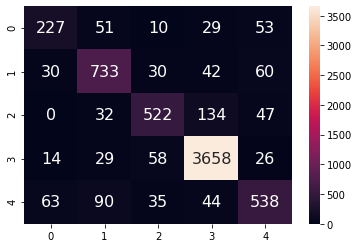

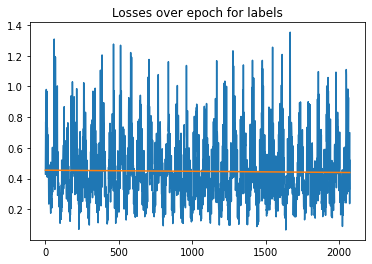

Intercept: 0.4547300400105945, slope: -7.2827110831759205e-06
Running inference on validation batch 109

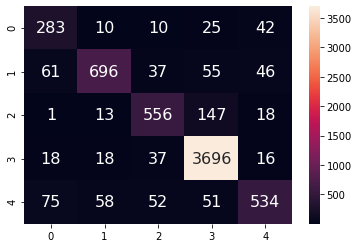

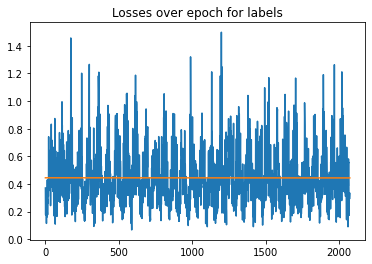

Intercept: 0.444996922624477, slope: -4.4058078691343587e-07
Running inference on validation batch 109

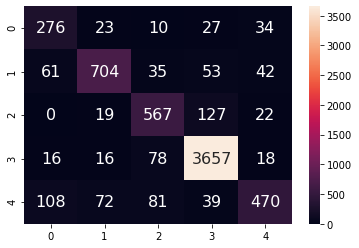

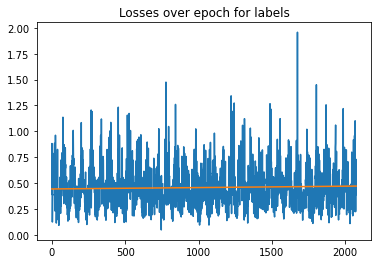

Intercept: 0.4421907526623008, slope: 1.3420266633327183e-05
Running inference on validation batch 109

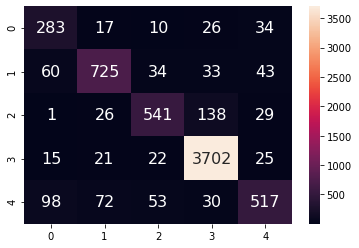

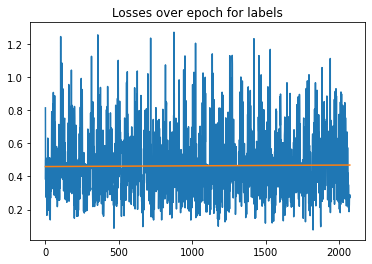

Intercept: 0.45986578504760034, slope: 4.427405147047117e-06
Running inference on validation batch 109

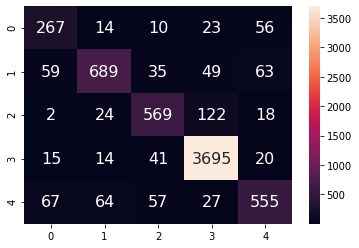

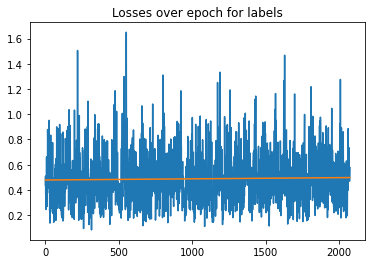

Intercept: 0.4785248439501541, slope: 9.282716346180066e-06
Running inference on validation batch 109

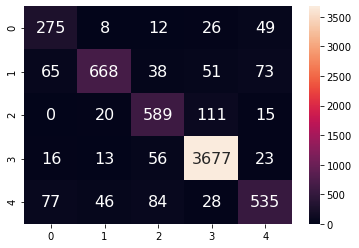

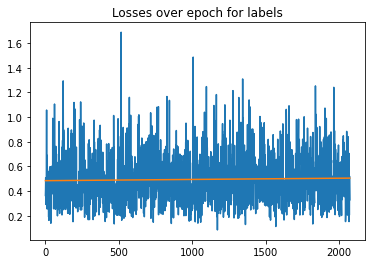

Intercept: 0.4850580395149051, slope: 9.942803861192605e-06
Running inference on validation batch 109

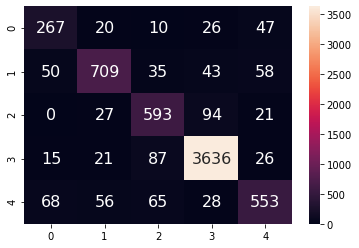

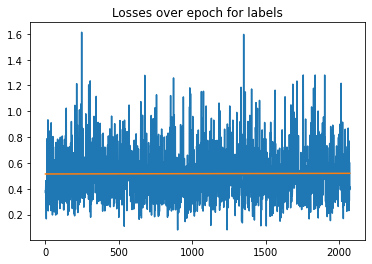

Intercept: 0.5145955115671822, slope: 2.386949547498118e-06
Running inference on validation batch 109

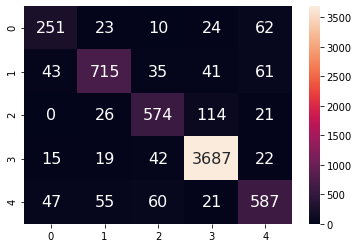

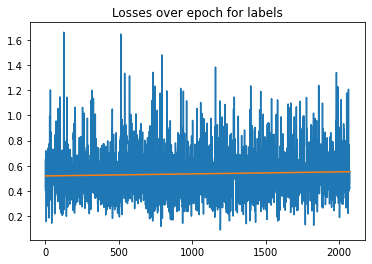

Intercept: 0.5200391736095658, slope: 1.6024952445434985e-05
Running inference on validation batch 109

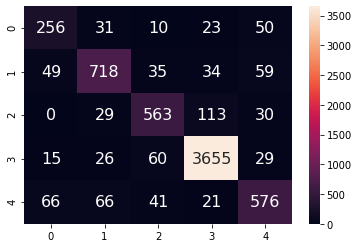

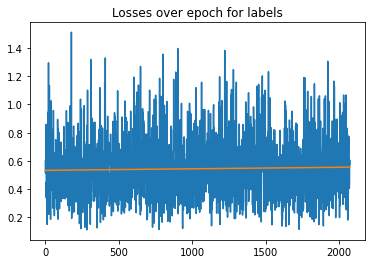

Intercept: 0.5329052099194791, slope: 1.0865995419436248e-05
Running inference on validation batch 109

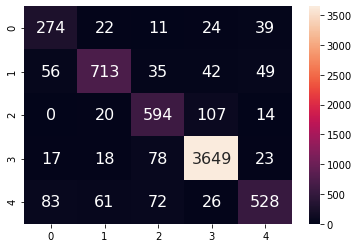

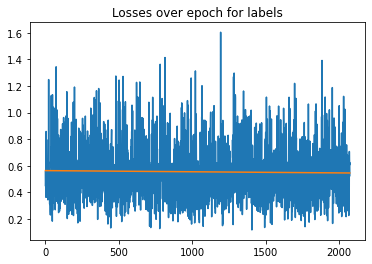

Intercept: 0.5635774694552226, slope: -8.565532845472677e-06
Running inference on validation batch 109

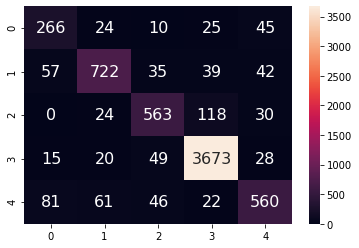

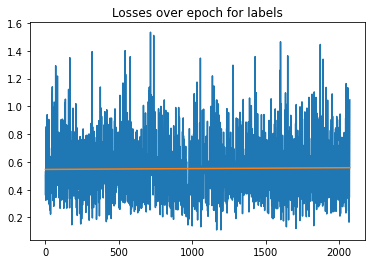

Intercept: 0.5457078442219788, slope: 6.047154877444542e-06
Running inference on validation batch 109

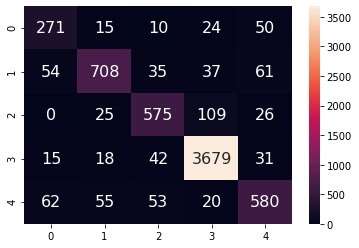

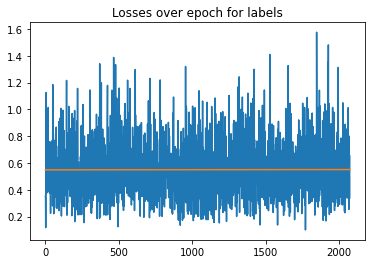

Intercept: 0.5487667051370486, slope: 1.0638878810897623e-06
Running inference on validation batch 109

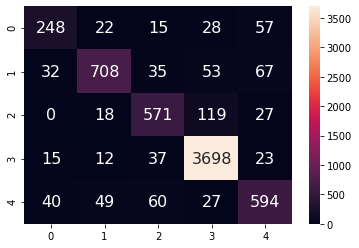

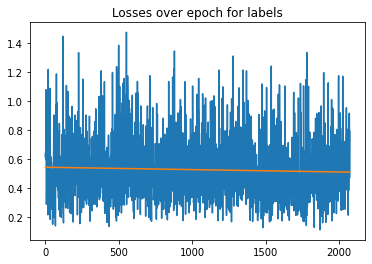

Intercept: 0.544582730839647, slope: -1.6406117848923794e-05
Running inference on validation batch 109

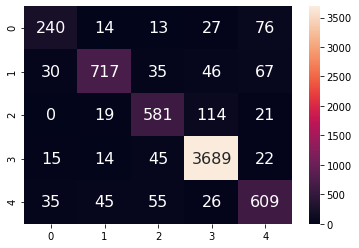

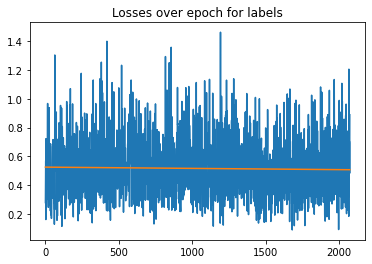

Intercept: 0.5257053031649874, slope: -8.679275622533707e-06
Running inference on validation batch 109

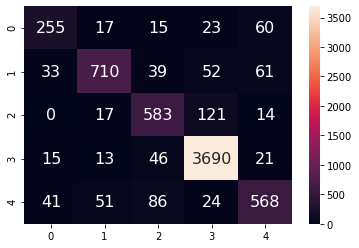

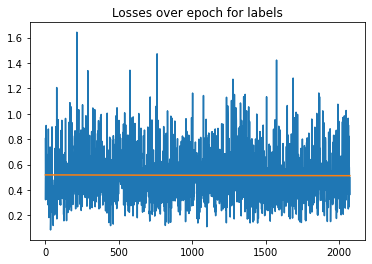

Intercept: 0.5190735226868338, slope: -3.0164236903146433e-06
Total training time for network: 15.682169451647335 hours.


In [12]:
start_time = time.time()
instance_loss_history = defaultdict(list)
train_dir = f"training/train_{config['timestamp']}"
os.makedirs(train_dir)

with open(f'{train_dir}/train_log.csv', 'w+') as train_log:
    train_log.write('epoch_expected_loss_change,valid_accuracy\n')

config.to_json(f'{train_dir}/config.json')

for epoch_i in range(config['total_epochs']):
    model.train()
    
    if epoch_i < config['tune_epoch_threshold']:
        batch_losses, instance_losses = sam_mixup_epoch(model, optimizer, criterion, train_loader, lr_scheduler, class_weight_scheduler)
    else:
        batch_losses, instance_losses = sam_mixup_epoch(model, optimizer, criterion, train_tune_loader, lr_scheduler, class_weight_scheduler)
    if config['lr_scheduler'] == 'multiplicative':
        lr_scheduler.step()
    for key, loss in instance_losses:
        instance_loss_history[key].append(loss)
    model.eval()
    valid_acc = validate_model(model, valid_loader, f'Epoch {epoch_i}', label_map)
    label_b, label_m = plot_curve_w_linefit(batch_losses, 'Losses over epoch for labels')
    print(f'Intercept: {label_b}, slope: {label_m}')
    torch.save(model, f'{train_dir}/model_epoch_{epoch_i}.pickle')
    
    with open(f'{train_dir}/train_log.csv', 'a') as train_log:
        train_log.write(f'{label_m},{valid_acc}\n')
    
running_time = time.time() - start_time
print(f'Total training time for network: {running_time / 60 / 60} hours.')

In [13]:
from numpy.polynomial.polynomial import polyfit

def compute_instance_expected_loss_slopes():
    instance_expected_loss_slopes = {}
    for key, losses in instance_loss_history.items():
        b, m = polyfit(np.arange(len(losses)), losses, 1)
        instance_expected_loss_slopes[key] = m